# ***Landfill Detection***

In [1]:
!git clone https://github.com/yibork/aerialwaste-model.git /content/temp_repo
!mv /content/temp_repo/* /content/
!rm -rf /content/temp_repo

Cloning into '/content/temp_repo'...
remote: Enumerating objects: 53, done.
remote: Counting objects: 100% (53/53), done.
remote: Compressing objects: 100% (50/50), done.
remote: Total 53 (delta 17), reused 17 (delta 1), pack-reused 0
Receiving objects: 100% (53/53), 401.12 KiB | 13.37 MiB/s, done.
Resolving deltas: 100% (17/17), done.
Error downloading object: weights/checkpoint.pth (936fc4e): Smudge error: Error downloading weights/checkpoint.pth (936fc4e8da08ffe62a8315e69f47f7175307c2f0748fa5f74dd11eda3f059b72): batch response: This repository is over its data quota. Account responsible for LFS bandwidth should purchase more data packs to restore access.

Errors logged to /content/temp_repo/.git/lfs/logs/20230720T234231.847147089.log
Use `git lfs logs last` to view the log.
error: external filter 'git-lfs filter-process' failed
fatal: weights/checkpoint.pth: smudge filter lfs failed
You can inspect what was checked out with 'git status'
and retry with 'git restore --source=HEAD :/'


In [2]:
!pip install pytorch-ignite

In [3]:
import os
import glob
# Local libraries
from utils.image_processor import ImageProcessor


In [4]:
CATS = ["suspicius_site"]


In [5]:
STATE_DICT_PATH = "weights/checkpoint.pth"
model = 'architecture.resnet50_fpn'


In [6]:
ip = ImageProcessor(CATS, STATE_DICT_PATH, model=model)


Image: Casa_2.png, Scores: [0.1940779], Predicted Categories: {}


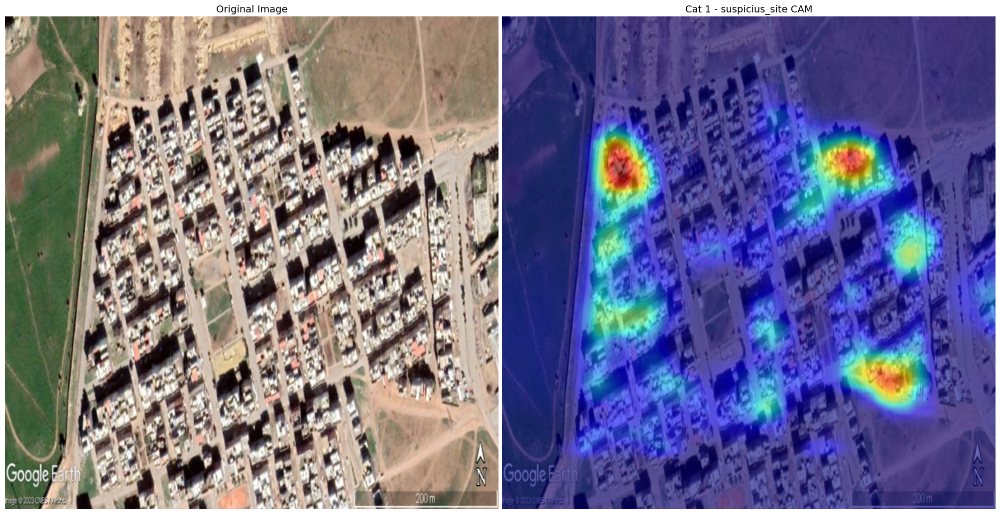

Image: Casa_6.png, Scores: [0.55972093], Predicted Categories: {'suspicius_site': 0.55972093}


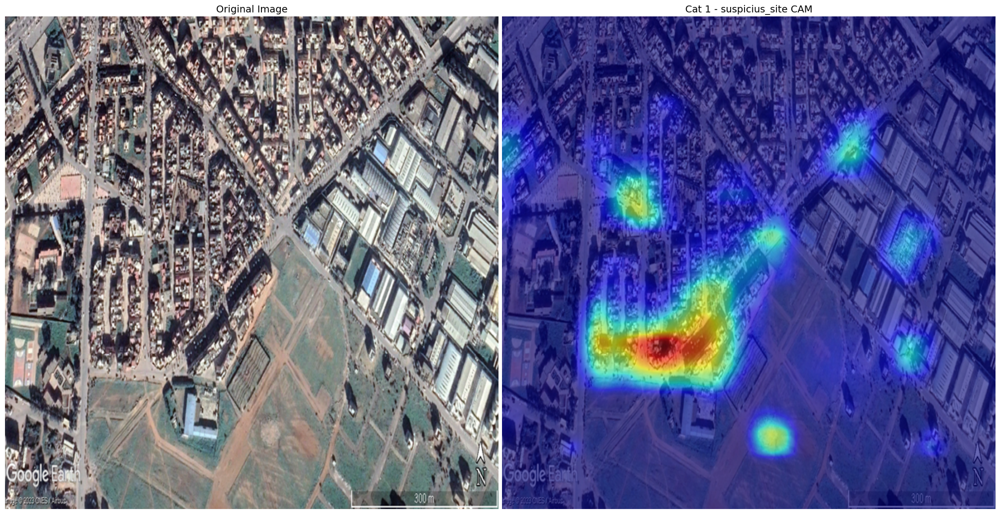

Image: Casa_5.png, Scores: [0.26530308], Predicted Categories: {}


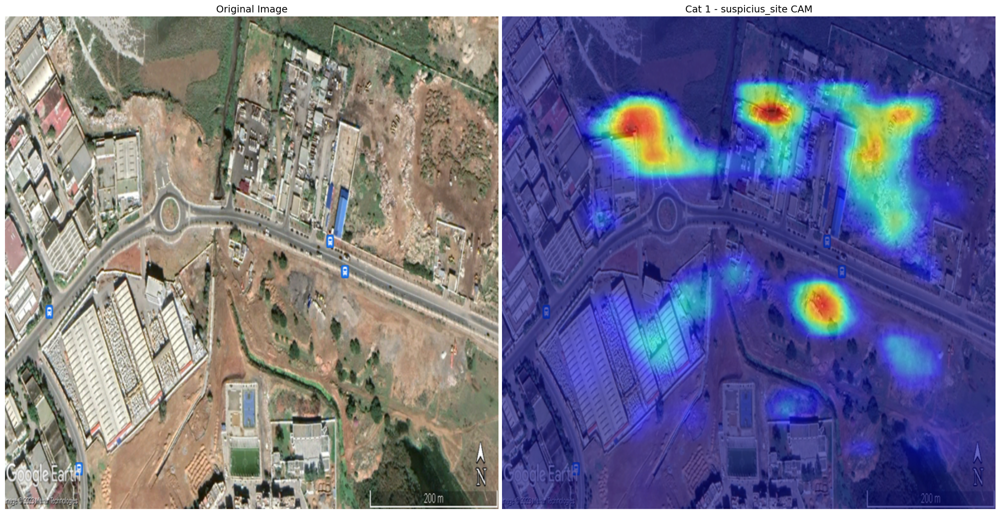

Image: Casa_7.png, Scores: [0.720972], Predicted Categories: {'suspicius_site': 0.720972}


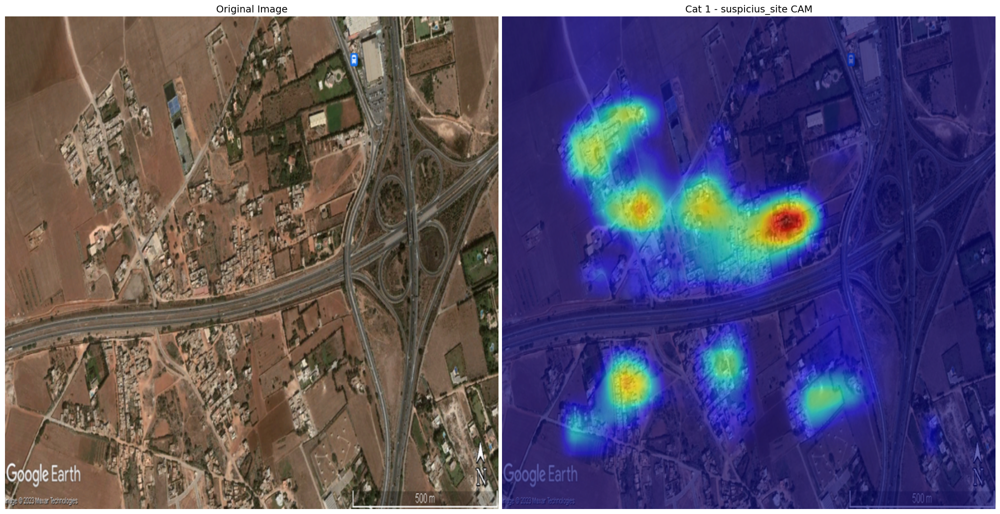

Image: Casa_4.png, Scores: [0.28687143], Predicted Categories: {}


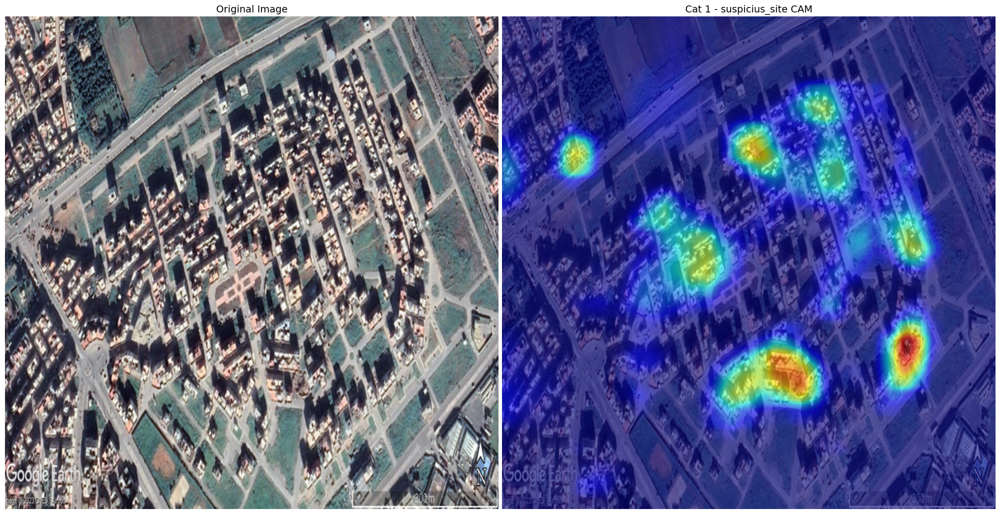

Image: Casa_3.png, Scores: [0.2608769], Predicted Categories: {}


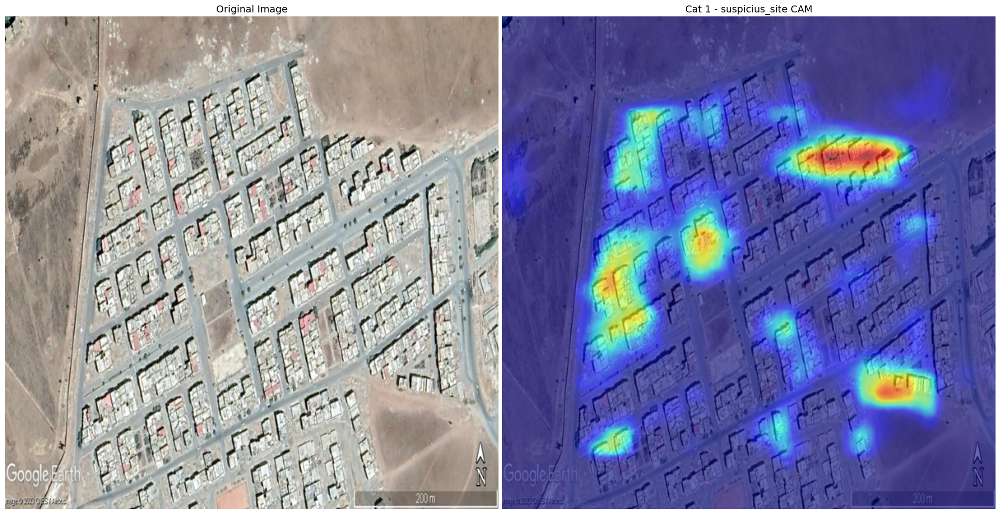

Image: Casa_9.png, Scores: [0.05137879], Predicted Categories: {}


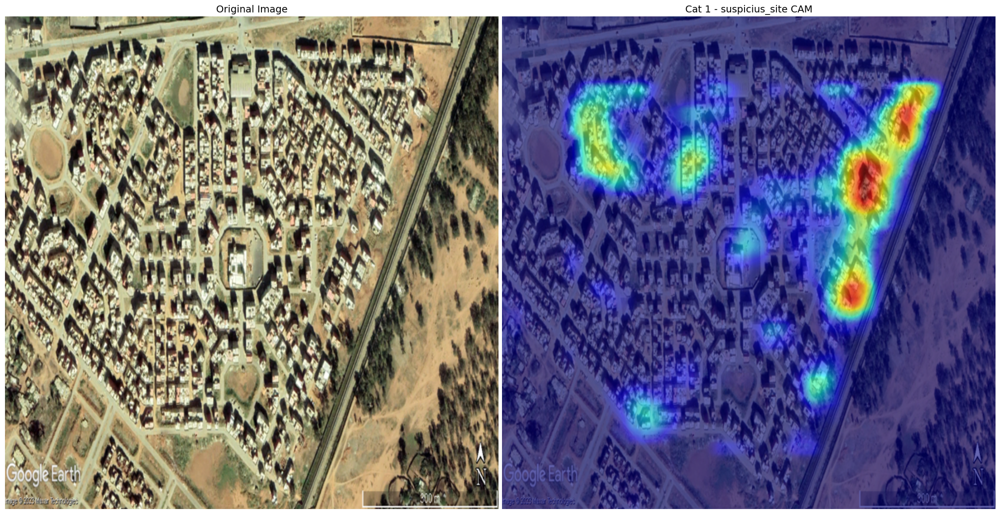

Image: Casa_1.png, Scores: [0.2632948], Predicted Categories: {}


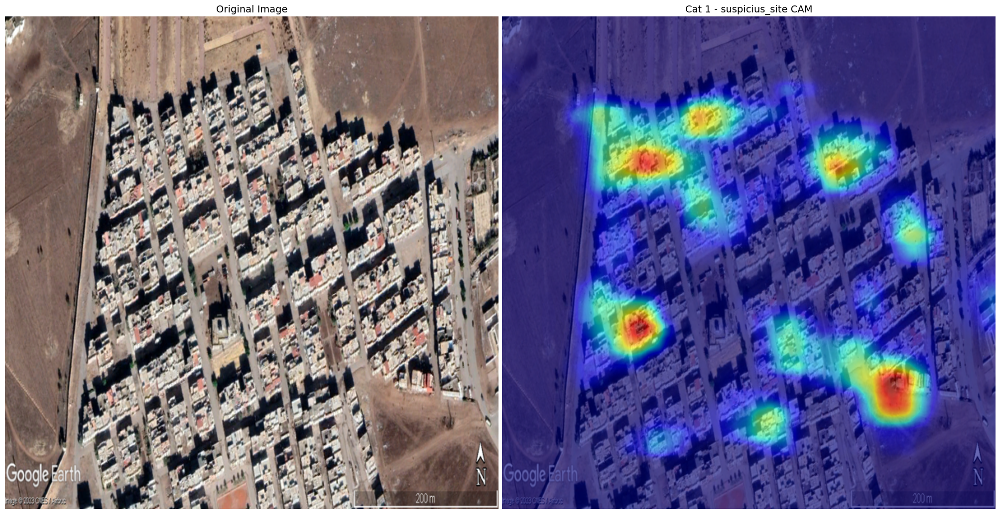

Image: Casa_8.png, Scores: [0.3389159], Predicted Categories: {}


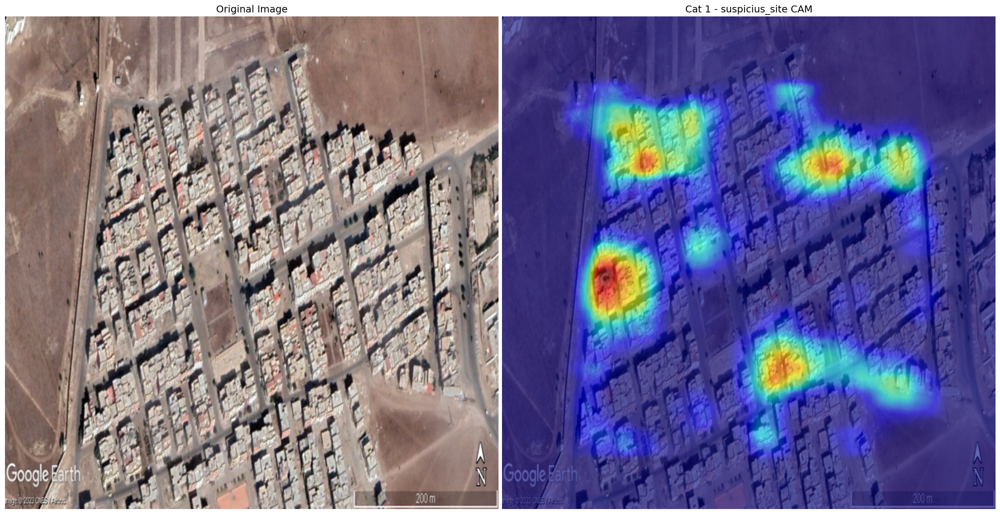

In [58]:

# Define the path to the directory containing your group of PNG images
image_directory = 'test_img/'

# List all the PNG image files in the directory
image_files = [f for f in os.listdir(image_directory) if f.endswith('.png')]
cams_dict = {}

# Loop through the PNG image files and process each image
for img_file in image_files:
    img_path = os.path.join(image_directory, img_file)
    iw = ip.execute_cams_pred(img_path)

    # Print the classification scores and predicted categories for each image
    print(f"Image: {img_file}, Scores: {iw.classification_scores}, Predicted Categories: {iw.predicted_categories}")

    # Display the global Class Activation Maps (CAMs) associated with the predictions


    cams = iw.show_global_cams()
    cams_dict[img_file] = cams




# ***Area Extract***

In [77]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Assuming `execute_cams_pred` returns an object of the `ImageWrapper` class
iw = ip.execute_cams_pred("test_img/Casa_7.png")

# Assuming `cams` contains the CAMs
cams = iw.global_cams

# Assuming `classification_scores` contains the scores for each category
classification_scores = iw.classification_scores

# Find the index of the predicted category with the highest score
predicted_category_index = classification_scores.argmax()

# Threshold the CAMs to create a binary mask for the predicted class
threshold = 0.5  # Adjust the threshold as needed
predicted_class_mask = cams[predicted_category_index] > threshold

# Access the original image from the `ImageWrapper` object
original_image = iw.image.copy()

# Apply the binary mask to extract the predicted object from the original image
predicted_object = original_image * predicted_class_mask[:, :, np.newaxis]

In [76]:
# Convert the predicted object to grayscale for easier pixel counting
predicted_object_gray = cv2.cvtColor(predicted_object, cv2.COLOR_BGR2GRAY)

# Count the number of non-zero pixels
num_non_zero_pixels = np.count_nonzero(predicted_object_gray)

area_m2 = (num_non_zero_pixels * 10 * 10)/1000000

print("surfArea:", area_m2)


Area: 0.932


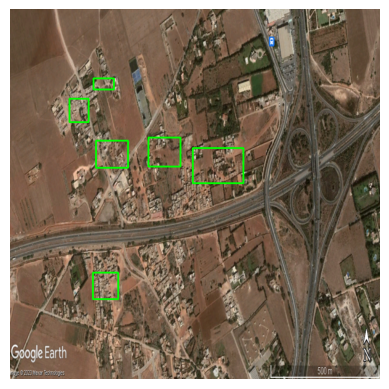

In [64]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Assuming `execute_cams_pred` returns an object of the `ImageWrapper` class
iw = ip.execute_cams_pred("test_img/Casa_7.png")

# Assuming `cams` contains the CAMs
cams = iw.global_cams

# Assuming `classification_scores` contains the scores for each category
classification_scores = iw.classification_scores

# Find the index of the predicted category with the highest score
predicted_category_index = classification_scores.argmax()

# Threshold the CAMs to create a binary mask for the predicted class
threshold = 0.5  # Adjust the threshold as needed
predicted_class_mask = cams[predicted_category_index] > threshold

# Find contours in the binary mask
contours, _ = cv2.findContours(predicted_class_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Access the original image from the `ImageWrapper` object
original_image = iw.image.copy()

# Draw bounding boxes around the detected contours
for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    cv2.rectangle(original_image, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Draw green bounding box

# Display the original image with bounding boxes
plt.imshow(original_image)
plt.axis('off')
plt.show()


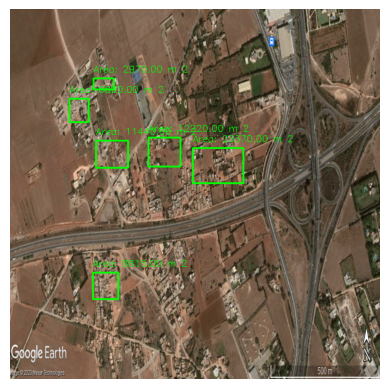

In [69]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Assuming `execute_cams_pred` returns an object of the `ImageWrapper` class
iw = ip.execute_cams_pred("test_img/Casa_7.png")

# Assuming `cams` contains the CAMs
cams = iw.global_cams

# Assuming `classification_scores` contains the scores for each category
classification_scores = iw.classification_scores

# Find the index of the predicted category with the highest score
predicted_category_index = classification_scores.argmax()

# Threshold the CAMs to create a binary mask for the predicted class
threshold = 0.5  # Adjust the threshold as needed
predicted_class_mask = cams[predicted_category_index] > threshold

# Find contours in the binary mask
contours, _ = cv2.findContours(predicted_class_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Access the original image from the `ImageWrapper` object
original_image = iw.image.copy()

# Pixel-to-meter conversion factor (each pixel represents 10 square meters)
pixel_to_meter = 5.0

# Calculate the area in square meters and draw bounding boxes around the detected contours
for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    area_pixels = w * h
    area_m2 = area_pixels * pixel_to_meter
    cv2.rectangle(original_image, (x, y), (x + w, y + h), (0, 255, 0), 2)  # Draw green bounding box
    cv2.putText(original_image, f"Area: {area_m2:.2f} m 2", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

# Display the original image with bounding boxes and areas in square meters
plt.imshow(original_image)
plt.axis('off')
plt.show()



# **Generate Text**

In [ ]:
!pip install -q datasets loralib sentencepiece
!pip uninstall transformers
!pip install -q git+https://github.com/zphang/transformers@c3dc391
!pip -q install git+https://github.com/huggingface/peft.git
!pip -q install bitsandbytes

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 486.2/486.2 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 11.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 10.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 12.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 46.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.2/244.2 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 38.5 MB/s eta 0:00:00
     ━━

In [ ]:
from peft import PeftModel
from transformers import LLaMATokenizer, LLaMAForCausalLM, GenerationConfig
import textwrap

In [ ]:
tokenizer = LLaMATokenizer.from_pretrained("decapoda-research/llama-7b-hf")

model = LLaMAForCausalLM.from_pretrained(
    "decapoda-research/llama-7b-hf",
    load_in_8bit=True,
    device_map="auto",
)
model = PeftModel.from_pretrained(model, "samwit/alpaca7B-lora")

Overriding torch_dtype=None with `torch_dtype=torch.float16` due to requirements of `bitsandbytes` to enable model loading in mixed int8. Either pass torch_dtype=torch.float16 or don't pass this argument at all to remove this warning.


Loading checkpoint shards:   0%|          | 0/33 [00:00<?, ?it/s]

In [ ]:
def alpaca_talk(text):
    inputs = tokenizer(
        text,
        return_tensors="pt",
    )
    input_ids = inputs["input_ids"].cuda()

    generation_config = GenerationConfig(
        temperature=0.6,
        top_p=0.95,
        repetition_penalty=1.2,
    )
    print("Generating...")
    generation_output = model.generate(
        input_ids=input_ids,
        generation_config=generation_config,
        return_dict_in_generate=True,
        output_scores=True,
        max_new_tokens=256,
    )
    for s in generation_output.sequences:
        print(tokenizer.decode(s))

In [ ]:
input_text ='''Below is an instruction that describes a task. Write a response that appropriately completes the request.

### Instruction:
The authorities need to get ready for the expansion of a landfill, which is predicted to cover '''+ area_m2+ ''' square meters next month. To handle this, estimate the required number of employees based on the waste type, density, and specific tasks involved.

### Response:
'''

alpaca_talk(input_text)

Generating...
 Below is an instruction that describes a task. Write a response that appropriately completes the request.

### Instruction:
The authorities need to get ready for the expansion of a landfill, which is predicted to cover 2000 square meters next month. To handle this, estimate the required number of employees based on the waste type, density, and specific tasks involved.

### Response:
Based on the estimated amount of waste expected in the coming months (15 tons per day), we can assume there will be approximately 45 workers needed to manage the site. The types of waste being handled are organic matter, plastic, metal, glass, paper/cardboard, wood, etc., with each requiring different handling methods depending on their physical properties. For example, heavy metals such as lead or mercury require specialized equipment and training while lightweight materials like cardboard may only require simple sorting techniques. Based on these factors, it would take about 3-6 people to s